In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

datasets_dir = "../DataSet"

# DataSet Selection


## 2017 Datasets


In [2]:
# Friday afternon have the DDoS attacks
df17_Friday_DDoS = pd.read_csv(
    os.path.join(datasets_dir, "2017/TrafficLabelling/Friday-Afternoon-DDos.csv")
)
# wednesday have the DoS attacks
df17_Wednesday = pd.read_csv(
    os.path.join(datasets_dir, "2017/TrafficLabelling/Wednesday.csv")
)
# monday contain normal trafic
df17_Monday = pd.read_csv(
    os.path.join(datasets_dir, "2017/TrafficLabelling/Monday.csv")
)

In [18]:
# droping non DOS attacks
df17_Wednesday = df17_Wednesday[df17_Wednesday[" Label"] != "Heartbleed"]

In [4]:
df17_Friday_DDoS.head()

,Flow ID,Source IP,Source Port,Destination IP,Destination Port,Protocol,Timestamp,Flow Duration,Total Fwd Packets,Total Backward Packets,...,min_seg_size_forward,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Label
0,192.168.10.5-104.16.207.165-54865-443-6,104.16.207.165,443,192.168.10.5,54865,6,7/7/2017 3:30,3,2,0,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
1,192.168.10.5-104.16.28.216-55054-80-6,104.16.28.216,80,192.168.10.5,55054,6,7/7/2017 3:30,109,1,1,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
2,192.168.10.5-104.16.28.216-55055-80-6,104.16.28.216,80,192.168.10.5,55055,6,7/7/2017 3:30,52,1,1,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
3,192.168.10.16-104.17.241.25-46236-443-6,104.17.241.25,443,192.168.10.16,46236,6,7/7/2017 3:30,34,1,1,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
4,192.168.10.5-104.19.196.102-54863-443-6,104.19.196.102,443,192.168.10.5,54863,6,7/7/2017 3:30,3,2,0,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN


In [3]:
print("Dos Data", df17_Wednesday.shape)
print("DDos Data", df17_Friday_DDoS.shape)
print("Normal Data", df17_Monday.shape)

Dos Data (692703, 85)
DDos Data (225745, 85)
Normal Data (529918, 85)


In [23]:
# merging the dataset
df17_DOS_DDoS = pd.concat([df17_Friday_DDoS, df17_Wednesday, df17_Monday])

In [25]:
# fixing the whitespace problem in column naming
for i in df17_DOS_DDoS.columns:
    df17_DOS_DDoS = df17_DOS_DDoS.rename(columns={i: i.strip()})

## 2018 Datasets


In [19]:
def downcast(df):
    cols = df.dtypes.index.tolist()
    types = df.dtypes.values.tolist()
    for i, t in enumerate(types):
        if "int" in str(t):
            if (
                df[cols[i]].min() > np.iinfo(np.int8).min
                and df[cols[i]].max() < np.iinfo(np.int8).max
            ):
                df[cols[i]] = df[cols[i]].astype(np.int8)
            elif (
                df[cols[i]].min() > np.iinfo(np.int16).min
                and df[cols[i]].max() < np.iinfo(np.int16).max
            ):
                df[cols[i]] = df[cols[i]].astype(np.int16)
            elif (
                df[cols[i]].min() > np.iinfo(np.int32).min
                and df[cols[i]].max() < np.iinfo(np.int32).max
            ):
                df[cols[i]] = df[cols[i]].astype(np.int32)
            else:
                df[cols[i]] = df[cols[i]].astype(np.int64)
        elif "float" in str(t):
            if (
                df[cols[i]].min() > np.finfo(np.float16).min
                and df[cols[i]].max() < np.finfo(np.float16).max
            ):
                df[cols[i]] = df[cols[i]].astype(np.float16)
            elif (
                df[cols[i]].min() > np.finfo(np.float32).min
                and df[cols[i]].max() < np.finfo(np.float32).max
            ):
                df[cols[i]] = df[cols[i]].astype(np.float32)
            else:
                df[cols[i]] = df[cols[i]].astype(np.float64)
    return df

In [4]:
datasets = [
    os.path.join(datasets_dir, "2018/02-21-2018.csv"),
    os.path.join(datasets_dir, "2018/02-20-2018.csv"),
    os.path.join(datasets_dir, "2018/02-15-2018.csv"),
    os.path.join(datasets_dir, "2018/02-16-2018.csv"),
]
df = pd.DataFrame()
for i in datasets:
    dataset = pd.read_csv(i)
    if dataset.shape[1] == 84:
        dataset.drop(columns=["Flow ID", "Src IP", "Src Port", "Dst IP"], inplace=True)
    dataset.drop(dataset[dataset["Label"] != "Benign"].index, inplace=True)
    dataset = dataset.apply(pd.to_numeric, errors="ignore")
    print(dataset.shape, np.unique(dataset.dtypes))
    df = pd.concat([df, dataset])
    print("df", df.shape)

(360833, 80) [dtype('int64') dtype('float64') dtype('O')]
df (360833, 80)
(7372557, 80) [dtype('int64') dtype('float64') dtype('O')]
df (7733390, 80)
(996077, 80) [dtype('int64') dtype('float64') dtype('O')]
df (8729467, 80)


C:\Users\mahdj\AppData\Local\Temp\ipykernel_16596\1932460562.py:5: DtypeWarning: Columns (0,1,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78) have mixed types. Specify dtype option on import or set low_memory=False.
  dataset=pd.read_csv(i)


(446772, 80) [dtype('int64') dtype('float64') dtype('O')]
df (9176239, 80)


In [15]:
df.drop(columns=["Timestamp"], inplace=True)
df.to_csv("../DataSet/normal_2018.csv")

In [16]:
# more models and better search

import pandas as pd

# Load the dataset
df = pd.read_csv("../DataSet/2017/2017_DOS_DDoS.csv", low_memory=False)

df = df[df["Label"] == "BENIGN"]
print("before", df.shape)

import numpy as np

# Replace infinite updated data with nan
df.replace([np.inf, -np.inf], np.nan, inplace=True)
# Drop rows with NaN
df.dropna(inplace=True)
# identify and remove duplicate rows
df.drop_duplicates(inplace=True)
print("after", df.shape)
df.drop(
    columns=[
        "Destination IP",
        "Timestamp",
        "Flow ID",
        "Fwd Header Length.1",
        "Source IP",
        "Source Port",
    ],
    inplace=True,
)

df.to_csv("../DataSet/normal_2017.csv")

before (1067667, 85)
after (1066802, 85)


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

datasets_dir = "../DataSet"
dataset_2019_dir = os.path.join(datasets_dir, "2019")
grouped_path = os.path.join(dataset_2019_dir, "normal_2019.csv")

for dataset in os.listdir(dataset_2019_dir):
    if dataset.endswith(".csv") and dataset != "2019_Grouped_2.csv":
        df_reader = pd.read_csv(
            os.path.join(dataset_2019_dir, dataset),
            chunksize=5000000,
            low_memory=False,
            usecols=lambda col: col
            != [
                "Unnamed: 0",
                "Flow ID",
                "Source IP",
                "Source Port",
                "Destination IP",
                "Fwd Header Length.1",
                "SimillarHTTP",
                "Inbound",
                "Timestame",
            ],
        )
        for df in df_reader:
            # fixing the whitespace problem in column naming
            for i in df.columns:
                df = df.rename(columns={i: i.strip()})
            df = df[df["Label"] == "BENIGN"]

            df.replace([np.inf, -np.inf], np.nan, inplace=True)
            # Drop rows with NaN
            df.dropna(inplace=True)
            if os.path.isfile(grouped_path):
                print("Updating dataset with", dataset, df.shape)
                df.to_csv(grouped_path, mode="a", index=False, header=False)
            else:
                print("Creating dataset", dataset, df.shape)
                df.to_csv(grouped_path, index=False)

Creating dataset DrDoS_DNS.csv (2747, 88)
Updating dataset with DrDoS_DNS.csv (607, 88)
Updating dataset with DrDoS_LDAP.csv (1592, 88)
Updating dataset with DrDoS_MSSQL.csv (1986, 88)
Updating dataset with DrDoS_NetBIOS.csv (1687, 88)
Updating dataset with DrDoS_NTP.csv (14271, 88)
Updating dataset with DrDoS_SNMP.csv (1411, 88)
Updating dataset with DrDoS_SNMP.csv (82, 88)
Updating dataset with DrDoS_SSDP.csv (755, 88)
Updating dataset with DrDoS_UDP.csv (2127, 88)
Updating dataset with LDAP.csv (5053, 88)
Updating dataset with MSSQL.csv (2529, 88)
Updating dataset with MSSQL.csv (242, 88)
Updating dataset with NetBIOS.csv (1299, 88)
Updating dataset with Portmap.csv (4697, 88)
Updating dataset with Syn.csv (35387, 88)
Updating dataset with Syn_01-12.csv (381, 88)
Updating dataset with TFTP.csv (2268, 88)
Updating dataset with TFTP.csv (756, 88)
Updating dataset with TFTP.csv (703, 88)
Updating dataset with TFTP.csv (1948, 88)
Updating dataset with TFTP.csv (19420, 88)
Updating datas

In [6]:
df = pd.read_csv(grouped_path)
# fixing the whitespace problem in column naming
for i in df.columns:
    df = df.rename(columns={i: i.strip()})
df.drop(
    columns=[
        "Unnamed: 0",
        "Flow ID",
        "Source IP",
        "Source Port",
        "Destination IP",
        "Fwd Header Length.1",
        "SimillarHTTP",
        "Inbound",
        "Timestamp",
    ],
    inplace=True,
)

In [8]:
df.to_csv(grouped_path, index=False)

In [10]:
df_2017 = pd.read_csv("../DataSet/normal_2017.csv")
print("2017", df_2017.shape)
df_2018 = pd.read_csv("../DataSet/normal_2018.csv")
print("2018", df_2018.shape)

2017 (1066802, 80)
2018 (9176239, 80)


In [13]:
df_2017.drop(columns=["Unnamed: 0"], inplace=True)

In [16]:
df_2017.columns == df_2018.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True])

In [17]:
df = pd.concat([df, df_2017, df_2018])

print("2019+2017+2018", df.shape)

2019+2017+2018 (10355772, 79)


In [20]:
df.replace([np.inf, -np.inf], np.nan, inplace=True)
# Drop rows with NaN
df.dropna(inplace=True)

In [23]:
print(df.shape)
df.drop_duplicates(inplace=True)
print(df.shape)

(10288292, 79)
(8239375, 79)


In [24]:
df = downcast(df)

Destination Port            int32
Protocol                     int8
Flow Duration               int32
Total Fwd Packets           int32
Total Backward Packets      int32
                           ...   
Idle Mean                 float32
Idle Std                  float32
Idle Max                  float32
Idle Min                  float32
Label                      object
Length: 79, dtype: object


In [26]:
df.to_csv("../DataSet/normal_dataset.csv", index=False)

In [27]:
df.shape

(8239375, 79)

In [ ]:
df18_02_21 = pd.read_csv(os.path.join(datasets_dir, "2018/02-21-2018.csv"))
df18_02_20 = pd.read_csv(os.path.join(datasets_dir, "2018/02-20-2018.csv"))
df18_02_15 = pd.read_csv(os.path.join(datasets_dir, "2018/02-15-2018.csv"))
df18_02_16 = pd.read_csv(os.path.join(datasets_dir, "2018/02-16-2018.csv"))

In [ ]:
print(df18_02_21.shape)
print(df18_02_20.shape)
print(df18_02_15.shape)
print(df18_02_16.shape)

In [4]:
attr = []
for i in df18_02_20.columns:
    if i in df18_02_15.columns:
        attr.append(i)
    else:
        print(i)

print("18_02_15 in 18_02_20", len(attr))

Flow ID
Src IP
Src Port
Dst IP
18_02_15 in 18_02_20 80


In [5]:
# droping column to make it able to merge
df18_02_20.drop(columns=["Flow ID", "Src IP", "Src Port", "Dst IP"], inplace=True)

In [ ]:
# merging the dataset
df18_DOS_DDoS = pd.concat([df18_02_21, df18_02_20, df18_02_16, df18_02_15])

In [9]:
columns_transformation = {
    "ACK Flag Cnt": "ACK Flag Count",
    "Bwd Blk Rate Avg": "Bwd Avg Bulk Rate",
    "Bwd Byts/b Avg": "Bwd Avg Bytes/Bulk",
    "Bwd Header Len": "Bwd Header Length",
    "Bwd IAT Tot": "Bwd IAT Total",
    "Bwd Pkt Len Max": "Bwd Packet Length Max",
    "Bwd Pkt Len Mean": "Bwd Packet Length Mean",
    "Bwd Pkt Len Min": "Bwd Packet Length Min",
    "Bwd Pkt Len Std": "Bwd Packet Length Std",
    "Bwd Pkts/s": "Bwd Packets/s",
    "Bwd Pkts/b Avg": "Bwd Avg Packets/Bulk",
    "Bwd Seg Size Avg": "Avg Bwd Segment Size",
    "Dst Port": "Destination Port",
    "ECE Flag Cnt": "ECE Flag Count",
    "FIN Flag Cnt": "FIN Flag Count",
    "Flow Byts/s": "Flow Bytes/s",
    "Flow Pkts/s": "Flow Packets/s",
    "Fwd Act Data Pkts": "act_data_pkt_fwd",
    "Fwd Blk Rate Avg": "Fwd Avg Bulk Rate",
    "Fwd Byts/b Avg": "Fwd Avg Bytes/Bulk",
    "Fwd Header Len": "Fwd Header Length",
    "Fwd IAT Tot": "Fwd IAT Total",
    "Fwd Pkt Len Max": "Fwd Packet Length Max",
    "Fwd Pkt Len Mean": "Fwd Packet Length Mean",
    "Fwd Pkt Len Min": "Fwd Packet Length Min",
    "Fwd Pkt Len Std": "Fwd Packet Length Std",
    "Fwd Pkts/b Avg": "Fwd Avg Packets/Bulk",
    "Fwd Pkts/s": "Fwd Packets/s",
    "Fwd Seg Size Avg": "Avg Fwd Segment Size",
    "Fwd Seg Size Min": "min_seg_size_forward",
    "Init Bwd Win Byts": "Init_Win_bytes_backward",
    "Init Fwd Win Byts": "Init_Win_bytes_forward",
    "PSH Flag Cnt": "PSH Flag Count",
    "Pkt Len Mean": "Packet Length Mean",
    "Pkt Len Std": "Packet Length Std",
    "Pkt Len Var": "Packet Length Variance",
    "Pkt Len Max": "Max Packet Length",
    "Pkt Len Min": "Min Packet Length",
    "Pkt Size Avg": "Average Packet Size",
    "RST Flag Cnt": "RST Flag Count",
    "SYN Flag Cnt": "SYN Flag Count",
    "Subflow Bwd Byts": "Subflow Bwd Bytes",
    "Subflow Bwd Pkts": "Subflow Bwd Packets",
    "Subflow Fwd Byts": "Subflow Fwd Bytes",
    "Subflow Fwd Pkts": "Subflow Fwd Packets",
    "Tot Bwd Pkts": "Total Backward Packets",
    "Tot Fwd Pkts": "Total Fwd Packets",
    "TotLen Bwd Pkts": "Total Length of Bwd Packets",
    "TotLen Fwd Pkts": "Total Length of Fwd Packets",
    "URG Flag Cnt": "URG Flag Count",
}

In [9]:
df18_DOS_DDoS = df18_DOS_DDoS.rename(columns=columns_transformation)
df18_DOS_DDoS.drop(df18_DOS_DDoS[df18_DOS_DDoS["Label"] == "Label"].index, inplace=True)
df18_DOS_DDoS.columns

Index(['Destination Port', 'Protocol', 'Timestamp', 'Flow Duration',
       'Total Fwd Packets', 'Total Backward Packets',
       'Total Length of Fwd Packets', 'Total Length of Bwd Packets',
       'Fwd Packet Length Max', 'Fwd Packet Length Std',
       'Fwd Packet Length Mean', 'Fwd Pkt Len Std', 'Bwd Packet Length Max',
       'Bwd Packet Length Min', 'Bwd Packet Length Mean',
       'Bwd Packet Length Std', 'Flow Bytes/s', 'Flow Packets/s',
       'Flow IAT Mean', 'Flow IAT Std', 'Flow IAT Max', 'Flow IAT Min',
       'Fwd IAT Total', 'Fwd IAT Mean', 'Fwd IAT Std', 'Fwd IAT Max',
       'Fwd IAT Min', 'Bwd IAT Total', 'Bwd IAT Mean', 'Bwd IAT Std',
       'Bwd IAT Max', 'Bwd IAT Min', 'Fwd PSH Flags', 'Bwd PSH Flags',
       'Fwd URG Flags', 'Bwd URG Flags', 'Fwd Header Length',
       'Bwd Header Length', 'Fwd Packets/s', 'Bwd Packets/s',
       'Min Packet Length', 'Max Packet Length', 'Packet Length Mean',
       'Packet Length Std', 'Packet Length Variance', 'FIN Flag Count',


In [14]:
df18_DOS_DDoS.to_csv(os.path.join(datasets_dir, "2018/2018_DOS_DDoS.csv", index=False))

In [13]:
df18_DOS_DDoS["Label"].unique()
for i in df18_DOS_DDoS["Label"].unique():
    print(i, df18_DOS_DDoS[df18_DOS_DDoS["Label"] == i].shape)

Benign (9176239, 80)
DDOS attack-LOIC-UDP (1730, 80)
DDOS attack-HOIC (686012, 80)
DDoS attacks-LOIC-HTTP (576191, 80)
DoS attacks-SlowHTTPTest (139890, 80)
DoS attacks-Hulk (461912, 80)
Label (1, 80)
DoS attacks-GoldenEye (41508, 80)
DoS attacks-Slowloris (10990, 80)


## 2019 Datasets


In [12]:
dataset_2019_dir = os.path.join(datasets_dir, "2019")
grouped_path = os.path.join(dataset_2019_dir, "2019_Attacks.csv")

for dataset in os.listdir(dataset_2019_dir):
    if dataset.endswith(".csv") and dataset != "2019_Grouped_2.csv":
        df_reader = pd.read_csv(
            os.path.join(dataset_2019_dir, dataset), chunksize=4000000, low_memory=False
        )
        for df in df_reader:
            # fixing the whitespace problem in column naming
            for i in df.columns:
                df = df.rename(columns={i: i.strip()})

            if os.path.isfile(grouped_path):
                print("Updating dataset with", dataset)
                df.to_csv(grouped_path, mode="a", index=False, header=False)
            else:
                print("Creating dataset")
                df.to_csv(grouped_path, index=False)

Creating dataset
Updating dataset with DrDoS_DNS.csv
Updating dataset with DrDoS_LDAP.csv
Updating dataset with DrDoS_MSSQL.csv
Updating dataset with DrDoS_MSSQL.csv
Updating dataset with DrDoS_NetBIOS.csv
Updating dataset with DrDoS_NetBIOS.csv
Updating dataset with DrDoS_NTP.csv
Updating dataset with DrDoS_SNMP.csv
Updating dataset with DrDoS_SNMP.csv
Updating dataset with DrDoS_SSDP.csv
Updating dataset with DrDoS_UDP.csv
Updating dataset with LDAP.csv
Updating dataset with MSSQL.csv
Updating dataset with MSSQL.csv
Updating dataset with NetBIOS.csv
Updating dataset with Portmap.csv
Updating dataset with Syn.csv
Updating dataset with Syn.csv
Updating dataset with Syn_01-12.csv
Updating dataset with TFTP.csv
Updating dataset with TFTP.csv
Updating dataset with TFTP.csv
Updating dataset with TFTP.csv
Updating dataset with TFTP.csv
Updating dataset with TFTP.csv
Updating dataset with UDP.csv
Updating dataset with UDPLag.csv
Updating dataset with UDPLag_01-12.csv


# Data Cleaning


## Cleanner Class


In [2]:
def deleteNaN(df):
    # Replace infinite updated data with nan
    df.replace([np.inf, -np.inf], np.nan, inplace=True)
    # Drop rows with NaN
    df.dropna(inplace=True)
    # identify and remove duplicate rows
    df.drop_duplicates(inplace=True)
    return df


def visualize_unique_values(df, savefile):
    # check unique value for each column attacks,event
    print("_________ Type attacks _________$")
    print(
        pd.DataFrame(
            [
                df["Label"].unique(),
                [
                    df[df["Label"] == value]["Label"].value_counts()[0]
                    for value in df["Label"].unique()
                ],
            ]
        )
    )
    print("_________              _________$")
    sns.set(rc={"figure.figsize": (15.7, 8.27)})
    # Plot Bar chart to understand event total of device
    p = sns.countplot(x="Label", data=df)
    plt.show()
    plt.clf()
    plt.savefig(savefile)


def visualize_correlation(df, savefile):
    # To find the correlation among
    # the columns using pearson method
    matrix_corr_pearson = df.corr(method="pearson", numeric_only=True)
    sns.set(rc={"figure.figsize": (80, 80)})
    sns.heatmap(
        matrix_corr_pearson,
        xticklabels=matrix_corr_pearson.columns,
        yticklabels=matrix_corr_pearson.columns,
        cmap="RdBu_r",
        annot=True,
        linewidth=0.5,
    )
    plt.show()
    plt.clf()
    plt.savefig(savefile)


def save_dataset(df, dataset_Path):
    if os.path.isfile(dataset_Path):
        print("Updating dataset ", dataset_Path, df.shape)
        df.to_csv(dataset_Path, mode="a", index=False, header=False)
    else:
        print("Creating dataset", dataset_Path, df.shape)
        df.to_csv(dataset_Path, index=False)

In [5]:
# load the dataset
def big_dataset_cleaner(dataset, dataset_clean, columns):
    df_reader = pd.read_csv(dataset, chunksize=5000000, low_memory=False)

    matrix_corr_pearson = pd.DataFrame()
    c = 0
    for df in df_reader:
        if columns != 0:
            df.drop(columns=columns, axis=1, inplace=True)

        df.drop(df[df["Label"] == "Label"].index, inplace=True)
        df = deleteNaN(df)
        matrix_corr_pearson = matrix_corr_pearson.add(
            df.corr(method="pearson", numeric_only=True), fill_value=0
        )
        c += 1

        if os.path.isfile(dataset_clean):
            print("Updating dataset ")
            df.to_csv(dataset_clean, mode="a", index=False, header=False)
        else:
            print("Creating dataset")
            df.to_csv(dataset_clean, index=False)

    # To find the correlation among
    # the columns using pearson method
    sns.set(rc={"figure.figsize": (80, 80)})
    sns.heatmap(
        matrix_corr_pearson / c,
        xticklabels=matrix_corr_pearson.columns,
        yticklabels=matrix_corr_pearson.columns,
        cmap="RdBu_r",
        annot=True,
        linewidth=0.5,
    )
    plt.show()
    plt.clf()

## 2017 Dataset


In [7]:
# load the dataset
df_2017 = pd.read_csv(
    os.path.join(datasets_dir, "2017/TrafficLabelling/2017_DOS_DDoS.csv"),
    low_memory=False,
)
df_2017.drop(
    columns=[
        "Destination IP",
        "Flow ID",
        "Fwd Header Length.1",
        "Source IP",
        "Source Port",
    ],
    inplace=True,
)
df_2017 = deleteNaN(df_2017)

_________ Type attacks _________$
         0       1              2                 3         4              5
0   BENIGN    DDoS  DoS slowloris  DoS Slowhttptest  DoS Hulk  DoS GoldenEye
1  1059290  128023           5692              5263    178179          10286
_________              _________$


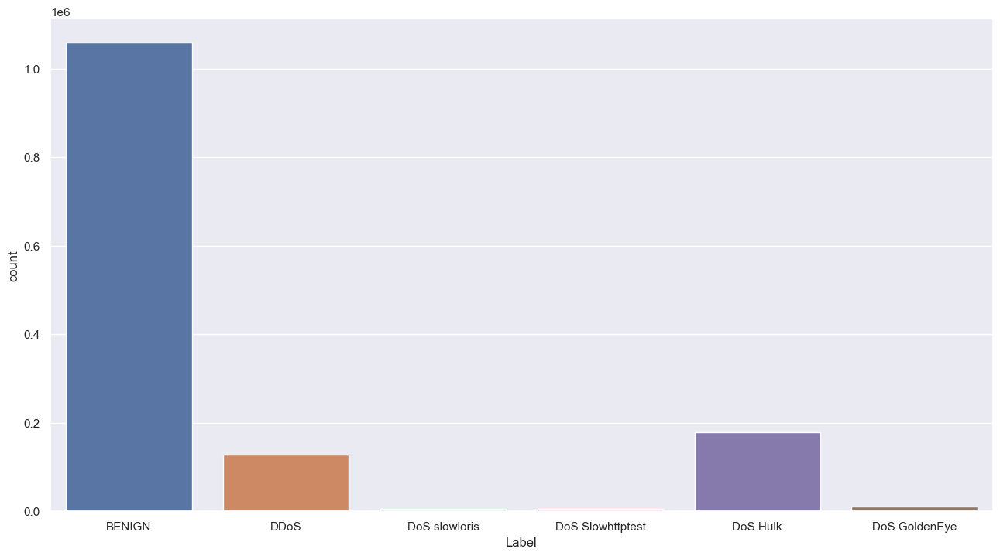

<Figure size 1570x827 with 0 Axes>

In [8]:
visualize_unique_values(df_2017)

In [11]:
save_dataset(df_2017, os.path.join(datasets_dir, "Cleanned_2.csv"))

Updating dataset  ../DataSet\Cleanned_2.csv (1386733, 80)


## 2018 Dataset


Updating dataset 
Updating dataset 
Updating dataset 


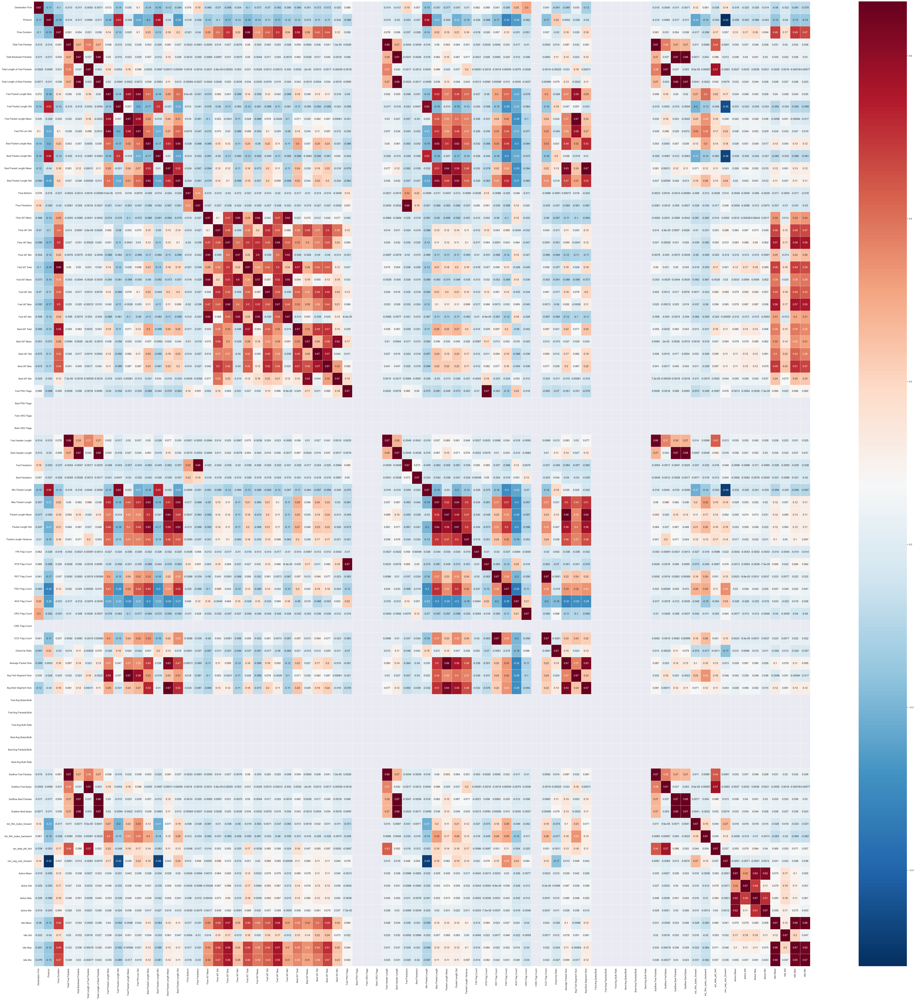

<Figure size 8000x8000 with 0 Axes>

In [6]:
# load the dataset
big_dataset_cleaner(
    os.path.join(datasets_dir, "2018/2018_DOS_DDoS.csv"),
    os.path.join(datasets_dir, "Cleanned_2.csv"),
    0,
)

## 2019 Dataset


In [ ]:
# load the dataset
big_dataset_cleaner(
    os.path.join(datasets_dir, "2019/attacks_2019.csv"),
    os.path.join(datasets_dir, "Cleanned_2.csv"),
    [
        "Unnamed: 0",
        "Flow ID",
        "Source IP",
        "Source Port",
        "Destination IP",
        "Fwd Header Length.1",
        "SimillarHTTP",
        "Inbound",
        "Timestame",
    ],
)

# Data Engineering


In [60]:
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE

rus = RandomUnderSampler(random_state=0)
smote = SMOTE(random_state=0)

Labels = pd.read_csv("label_count_Clean.csv")
Labels.drop(Labels[Labels["Labels"] == "BENIGN"].index, inplace=True)
# identify the minority and majority classes
minority_classes = Labels[Labels["Count"] < 1000000]["Labels"].tolist()
majority_classes = Labels[Labels["Count"] >= 5000000]["Labels"].tolist()
normal_classes = Labels[(Labels["Count"] < 5000000) & (Labels["Count"] >= 1000000)][
    "Labels"
].tolist()
normal_classes.append("BENIGN")

df_reader = pd.read_csv(
    os.path.join(datasets_dir, "Dataset_Cleaned.csv"),
    chunksize=4000000,
    low_memory=False,
)

for idx, df in enumerate(df_reader):
    print(df["Label"].unique())

    if pd.Series(normal_classes).isin(df["Label"].unique()).any():
        normal_mask = df["Label"].isin(normal_classes)
        normal_df = df[normal_mask]
        save_dataset(normal_df, os.path.join("C:\Test", "resampled_data.csv"))

    elif pd.Series(majority_classes).isin(df["Label"].unique()).any():
        # perform undersampling on the majority classes
        majority_mask = df["Label"].isin(majority_classes)
        majority_df = df[majority_mask]
        X_resampled, y_resampled = rus.fit_resample(
            majority_df.drop("Label", axis=1), majority_df["Label"]
        )
        majority_df_resampled = pd.concat(
            [pd.DataFrame(X_resampled), pd.DataFrame({"Label": y_resampled})], axis=1
        )
        save_dataset(
            majority_df_resampled, os.path.join("C:\Test", "resampled_data.csv")
        )

    elif pd.Series(minority_classes).isin(df["Label"].unique()).any():
        # perform data augmentation on the minority classes
        for minority_class in minority_classes:
            minority_mask = df["Label"] == minority_class
            print(minority_mask)
            minority_samples = df[minority_mask]

            X_resampled, y_resampled = smote.fit_resample(
                minority_samples.drop("Label", axis=1), minority_samples["Label"]
            )
            minority_df_resampled = pd.concat(
                [pd.DataFrame(X_resampled), pd.DataFrame({"Label": y_resampled})],
                axis=1,
            )

            save_dataset(
                minority_df_resampled, os.path.join("C:\Test", "resampled_data.csv")
            )

['DrDoS_DNS' 'BENIGN']
Creating dataset C:\Test\resampled_data.csv (4000000, 80)
['DrDoS_DNS' 'BENIGN' 'DrDoS_LDAP' 'DrDoS_MSSQL']
Updating dataset  C:\Test\resampled_data.csv (4000000, 80)
['DrDoS_MSSQL' 'BENIGN' 'DrDoS_NetBIOS']
Updating dataset  C:\Test\resampled_data.csv (4000000, 80)
['DrDoS_NetBIOS' 'BENIGN' 'DrDoS_NTP']
Updating dataset  C:\Test\resampled_data.csv (4000000, 80)
['DrDoS_NTP' 'BENIGN' 'DrDoS_SNMP']
Updating dataset  C:\Test\resampled_data.csv (629353, 80)
['DrDoS_SNMP' 'BENIGN' 'DrDoS_SSDP']
Updating dataset  C:\Test\resampled_data.csv (2221386, 80)
['DrDoS_SSDP' 'BENIGN' 'DrDoS_UDP' 'NetBIOS' 'LDAP']
Updating dataset  C:\Test\resampled_data.csv (4000000, 80)
['LDAP' 'BENIGN' 'MSSQL']
Updating dataset  C:\Test\resampled_data.csv (1515123, 80)
['MSSQL' 'BENIGN' 'NetBIOS']
Updating dataset  C:\Test\resampled_data.csv (924003, 80)
['NetBIOS' 'BENIGN' 'Portmap' 'Syn']
Updating dataset  C:\Test\resampled_data.csv (2437361, 80)
['Syn' 'BENIGN' 'TFTP']
Updating dataset  

In [61]:
df_reader = pd.read_csv(
    os.path.join("C:\Test", "resampled_data.csv"), chunksize=7000000, low_memory=False
)

count_unique = {}

for df in df_reader:
    # check unique attacks in the batch
    print(df["Label"].unique())
    for key in df["Label"].unique():
        unique_df = df[df["Label"] == key]["Label"].value_counts()[0]
        if key in count_unique:
            count_unique[key] += unique_df
        else:
            count_unique[key] = unique_df

pd.DataFrame({"Labels": count_unique.keys(), "Counts": count_unique.values()}).to_csv(
    "label_count_after_data_augmentation.csv", index=False
)

['DrDoS_DNS' 'BENIGN' 'DrDoS_LDAP']
['DrDoS_LDAP' 'BENIGN' 'DrDoS_MSSQL' 'DrDoS_NetBIOS']
['DrDoS_NetBIOS' 'BENIGN' 'DrDoS_NTP' 'DrDoS_SSDP' 'DrDoS_UDP']
['DrDoS_UDP' 'BENIGN' 'NetBIOS' 'LDAP' 'UDP']
['UDP' 'BENIGN']
['BENIGN']
_________ Type attacks _________$


NameError: name 'unique_Labels' is not defined

_________ Type attacks _________$
{'DrDoS_DNS': 4908665, 'BENIGN': 10272356, 'DrDoS_LDAP': 2141300, 'DrDoS_MSSQL': 4396046, 'DrDoS_NetBIOS': 3963446, 'DrDoS_NTP': 1195690, 'DrDoS_SSDP': 2568569, 'DrDoS_UDP': 3094002, 'NetBIOS': 3515894, 'LDAP': 1872139, 'UDP': 3790298}
_________              _________$


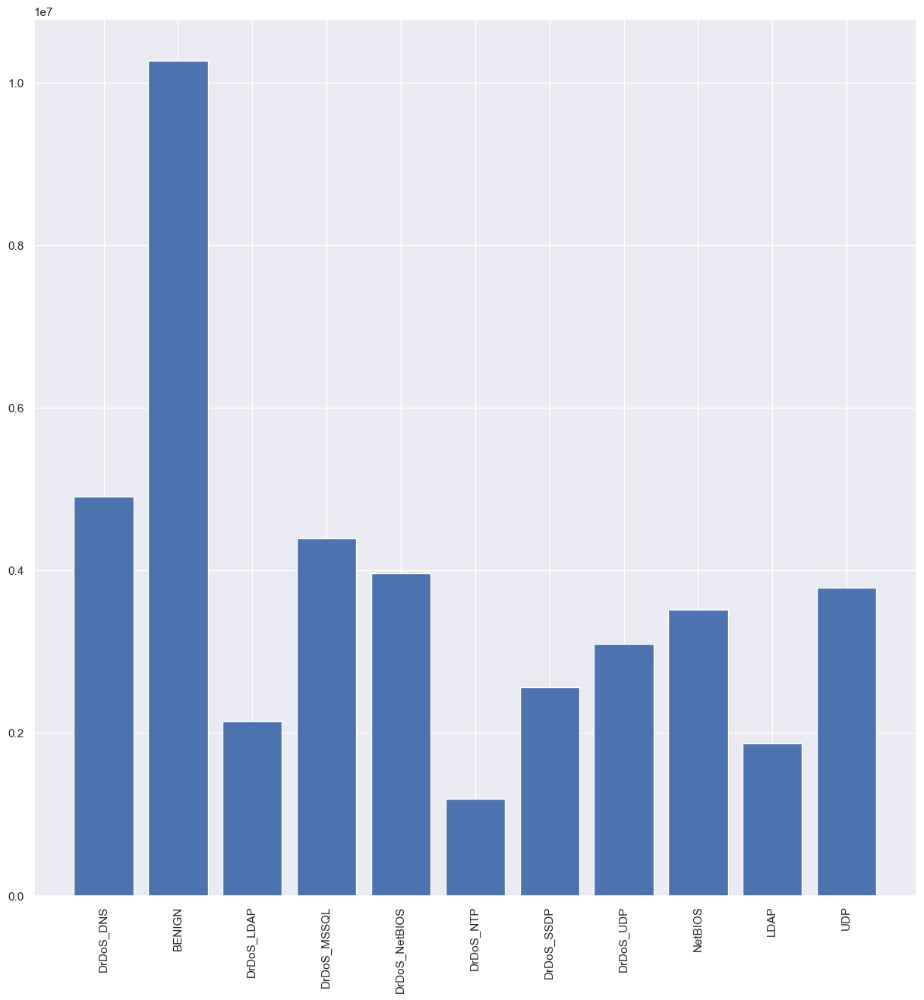

<Figure size 1500x1500 with 0 Axes>

In [62]:
# check unique value for each column attacks,event
print("_________ Type attacks _________$")
print(count_unique)
print("_________              _________$")
# Plot Bar chart to understand event total of device
sns.set(rc={"figure.figsize": (15, 15)})
plt.bar(count_unique.keys(), count_unique.values())
plt.xticks(rotation=90)
plt.show()
plt.clf()

# Feature engineering


## Ridge


In [3]:
from sklearn.linear_model import RidgeCV
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
import matplotlib

# initiate the df iterator
df_reader = pd.read_csv(
    os.path.join(datasets_dir, "Dataset_Cleaned.csv"),
    low_memory=False,
    chunksize=5000000,
)

# setting up the Tools
le = LabelEncoder()
scaler = StandardScaler(with_mean=True, with_std=True)
reg = RidgeCV(alphas=[1e-3, 1e-2, 1e-1, 1], cv=5)

# setting up the variables
total_score = 0
global_coef = None
n_samples = 0

for idx, df in enumerate(df_reader):
    # droping timestamp
    df.drop(columns="Timestamp", inplace=True)
    targets = df["Label"].unique()
    # encoding Labels
    label = le.fit_transform(df["Label"])
    df.drop("Label", axis=1, inplace=True)
    df["Label"] = label

    # Replace infinite updated data with nan
    df.replace([np.inf, -np.inf], np.nan, inplace=True)
    # Drop rows with NaN
    df.dropna(inplace=True)

    # spliting targete
    X = df.iloc[:, :-1]
    y = df.iloc[:, -1]
    col = X.columns

    # Standardize the data
    X = scaler.fit_transform(X)

    # fitting the estimator
    reg.fit(X, y)
    n_samples += X.shape[0]

    # calcuating the coefficients
    if global_coef is None:
        global_coef = reg.coef_
    else:
        global_coef += reg.coef_

    # calculating the scors
    batch_score = reg.score(X, y)
    total_score += batch_score

    print(idx + 1, "score ", batch_score, "Target", targets, sep="  ", end="\t")
    print(
        "features : picked :"
        + str(sum(reg.coef_ != 0))
        + "| eliminated :"
        + str(sum(reg.coef_ == 0))
    )

1  score   0.029892818129690468  Target  ['DrDoS_DNS' 'BENIGN' 'DrDoS_LDAP']	features : picked :66| eliminated :12
2  score   0.8455169088836478  Target  ['DrDoS_LDAP' 'BENIGN' 'DrDoS_MSSQL']	features : picked :66| eliminated :12
3  score   0.5925130481731218  Target  ['DrDoS_MSSQL' 'BENIGN' 'DrDoS_NetBIOS']	features : picked :66| eliminated :12
4  score   0.9190424971859334  Target  ['DrDoS_NetBIOS' 'BENIGN' 'DrDoS_NTP' 'DrDoS_SNMP']	features : picked :66| eliminated :12
5  score   0.7324429829833861  Target  ['DrDoS_SNMP' 'BENIGN' 'DrDoS_SSDP' 'DrDoS_UDP']	features : picked :66| eliminated :12
6  score   0.2553054518980533  Target  ['DrDoS_UDP' 'BENIGN' 'NetBIOS' 'LDAP' 'MSSQL']	features : picked :66| eliminated :12
7  score   0.8978900949386871  Target  ['MSSQL' 'BENIGN']	features : picked :66| eliminated :12
8  score   0.9359180244724549  Target  ['MSSQL' 'BENIGN' 'NetBIOS' 'Portmap' 'Syn']	features : picked :66| eliminated :12
9  score   0.8357155376466892  Target  ['Syn' 'BENIGN'

Best alpha using built-in RidgeCV:  0.001
Best score using built-in RidgeCV:  0.7548632867139317
Ridge picked  69  variables and eliminated the other  9  variables


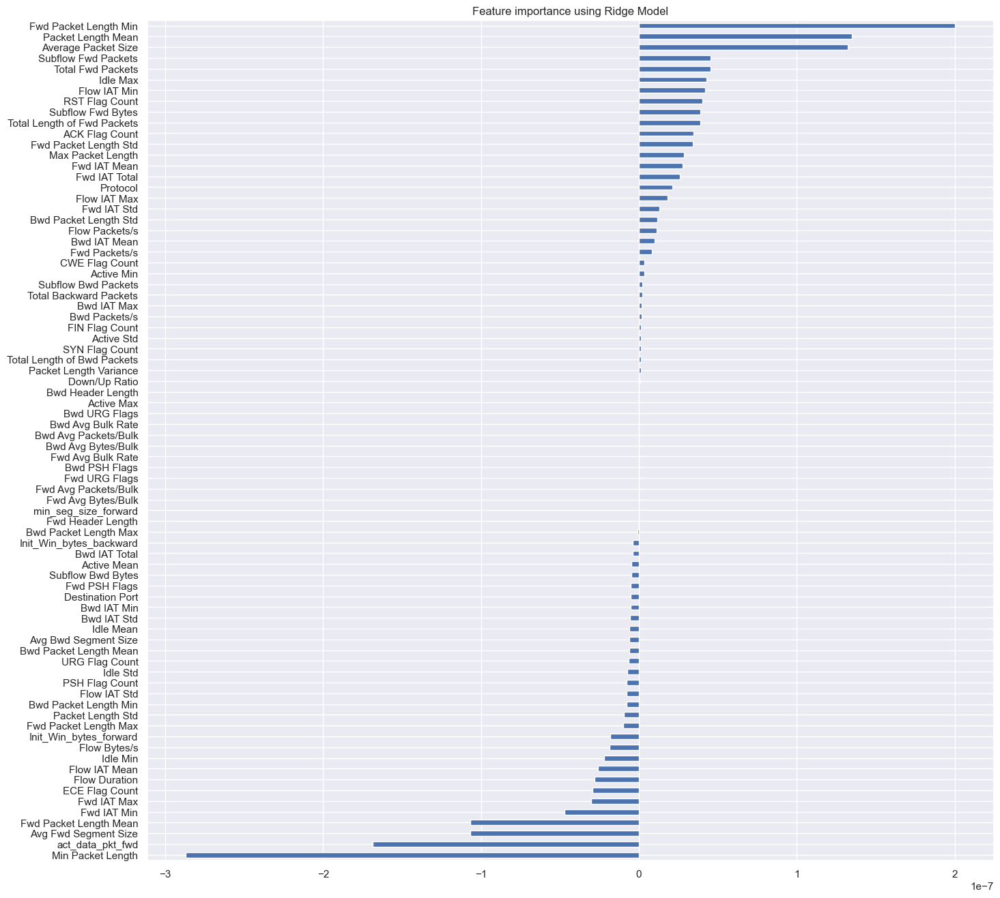

<Figure size 1600x1600 with 0 Axes>

In [8]:
# compute mean score and coefficients across all chunks
mean_score = total_score / (idx + 1)
mean_coef = global_coef / n_samples

# print results
print("Best alpha using built-in RidgeCV: ", reg.alpha_)
print("Best score using built-in RidgeCV: ", mean_score)
print(
    "Ridge picked ",
    np.sum(mean_coef != 0),
    " variables and eliminated the other ",
    np.sum(mean_coef == 0),
    " variables",
)

# plot feature importance
coef = pd.Series(mean_coef, index=col)
imp_coef = coef.sort_values()
sns.set(rc={"figure.figsize": (16, 16)})
imp_coef.plot(kind="barh")
plt.title("Feature importance using Ridge Model")
plt.show()
plt.savefig("Feature_Importance.png")

In [14]:
print(imp_coef[coef == 0].index)

Index(['Fwd Avg Bytes/Bulk', 'Fwd Avg Packets/Bulk', 'Fwd URG Flags',
       'Bwd PSH Flags', 'Fwd Avg Bulk Rate', 'Bwd Avg Bytes/Bulk',
       'Bwd Avg Packets/Bulk', 'Bwd Avg Bulk Rate', 'Bwd URG Flags'],
      dtype='object')


In [18]:
df_reader = pd.read_csv(
    os.path.join(datasets_dir, "Dataset_Cleaned.csv"),
    chunksize=8000000,
    low_memory=False,
)

matrix_corr_pearson_Full = pd.DataFrame()
matrix_corr_pearson_69F = pd.DataFrame()

for df in df_reader:
    # creating correlation matrix
    matrix_corr_pearson_Full = matrix_corr_pearson_Full.add(
        df.corr(method="pearson", numeric_only=True), fill_value=0
    )
    df.drop(columns=imp_coef[coef == 0].index, inplace=True)
    matrix_corr_pearson_69F = matrix_corr_pearson_69F.add(
        df.corr(method="pearson", numeric_only=True), fill_value=0
    )

    # saving the dataset
    save_dataset(df, os.path.join("C:\Test", "Dataset_Cleaned_69F.csv"))

Creating dataset C:\Test\Dataset_Cleaned_69F.csv (8000000, 71)
Updating dataset  C:\Test\Dataset_Cleaned_69F.csv (8000000, 71)
Updating dataset  C:\Test\Dataset_Cleaned_69F.csv (8000000, 71)
Updating dataset  C:\Test\Dataset_Cleaned_69F.csv (8000000, 71)
Updating dataset  C:\Test\Dataset_Cleaned_69F.csv (8000000, 71)
Updating dataset  C:\Test\Dataset_Cleaned_69F.csv (8000000, 71)
Updating dataset  C:\Test\Dataset_Cleaned_69F.csv (8000000, 71)
Updating dataset  C:\Test\Dataset_Cleaned_69F.csv (8000000, 71)
Updating dataset  C:\Test\Dataset_Cleaned_69F.csv (8000000, 71)
Updating dataset  C:\Test\Dataset_Cleaned_69F.csv (8000000, 71)
Updating dataset  C:\Test\Dataset_Cleaned_69F.csv (491233, 71)


## Correlation analysis


### Vizualise Full


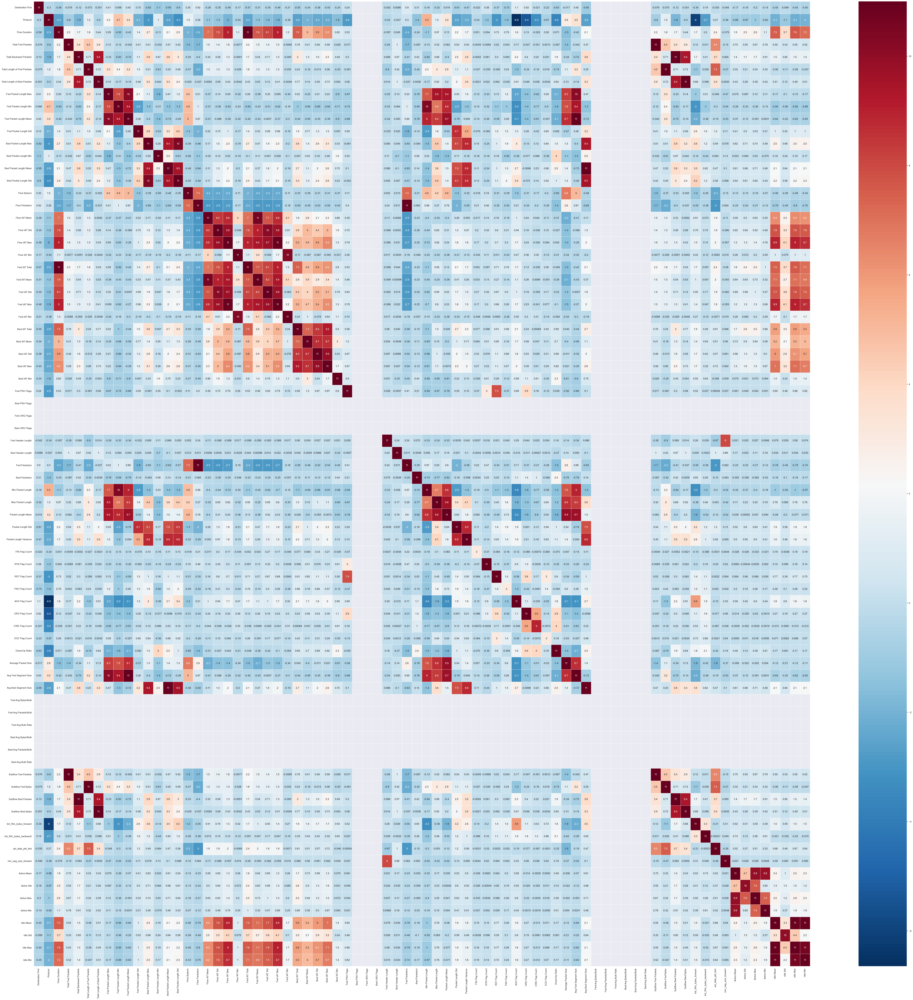

<Figure size 8000x8000 with 0 Axes>

In [19]:
sns.set(rc={"figure.figsize": (80, 80)})
sns.heatmap(
    matrix_corr_pearson_Full,
    xticklabels=matrix_corr_pearson_Full.columns,
    yticklabels=matrix_corr_pearson_Full.columns,
    cmap="RdBu_r",
    annot=True,
    linewidth=0.5,
)
plt.show()
plt.clf()

### VIsualize 69 Features


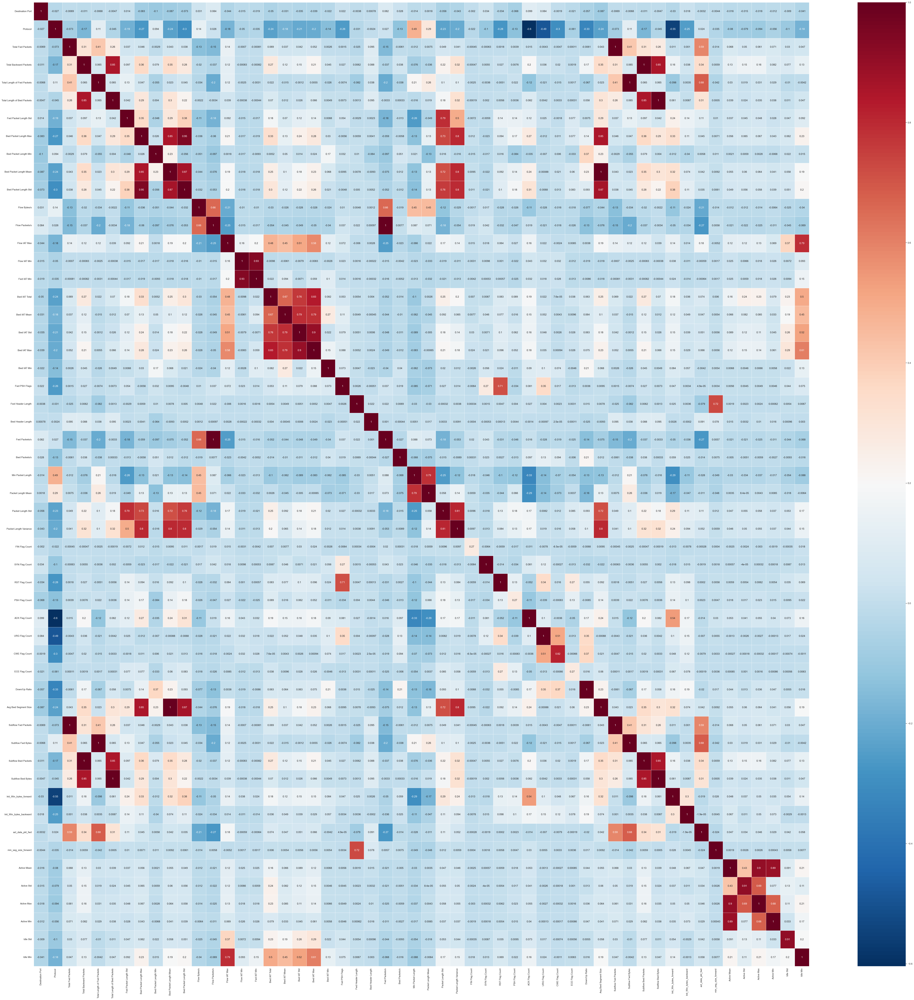

<Figure size 8000x8000 with 0 Axes>

In [171]:
sns.set(rc={"figure.figsize": (80, 80)})
sns.heatmap(
    matrix_corr_pearson_69F,
    xticklabels=matrix_corr_pearson_69F.columns,
    yticklabels=matrix_corr_pearson_69F.columns,
    cmap="RdBu_r",
    annot=True,
    linewidth=0.5,
)
plt.show()
plt.clf()

In [184]:
mx = matrix_corr_pearson_69F
droped = ["Subflow Fwd Packets", "Subflow Fwd Bytes", "Fwd Packets/s", "Fwd IAT Min"]
mx.drop(columns=droped, inplace=True)
mx.drop(index=droped, inplace=True)
row_ind, col_ind = np.where(mx > 0.8)
dropout = {}
for i, j in zip(row_ind, col_ind):
    row = matrix_corr_pearson_69F.index[i]
    col = matrix_corr_pearson_69F.columns[j]
    if row != col:
        print(row, col, matrix_corr_pearson_69F.loc[row, col], sep=" | ")
        if row in dropout.keys():
            dropout[row] += 1
        else:
            dropout[row] = 1

In [183]:
print(sorted(dropout.items(), key=lambda x: x[1]))

[('Total Fwd Packets', 1), ('Total Length of Fwd Packets', 1), ('Flow Packets/s', 1), ('Flow IAT Min', 1), ('Fwd IAT Min', 1), ('Fwd Packets/s', 1), ('Subflow Fwd Packets', 1), ('Subflow Fwd Bytes', 1)]


In [181]:
mx = matrix_corr_pearson_69F

target_row = "Bwd IAT Max"

for i, j in zip(row_ind, col_ind):
    row = matrix_corr_pearson_69F.index[i]
    col = matrix_corr_pearson_69F.columns[j]
    if (row != col) & (row == target_row):
        print("'", col, "'", sep="", end=",")

'Bwd IAT Total','Bwd IAT Std',

In [3]:
df_reader = pd.read_csv(
    os.path.join(datasets_dir, "Dataset_Cleaned_69F.csv"),
    chunksize=11000000,
    low_memory=False,
)

matrix_corr_pearson_69F = pd.DataFrame()
matrix_corr_pearson = pd.DataFrame()
dropout = [
    "Flow Duration",
    "Flow IAT Mean",
    "Flow IAT Std",
    "Fwd IAT Total",
    "Fwd IAT Mean",
    "Fwd IAT Std",
    "Fwd IAT Max",
    "Idle Mean",
    "Idle Max",
    "Fwd Packet Length Max",
    "Fwd Packet Length Min",
    "Fwd Packet Length Mean",
    "Max Packet Length",
    "Average Packet Size",
    "Avg Fwd Segment Size",
    "Bwd Packet Length Max",
    "Bwd Packet Length Mean",
    "Packet Length Std",
    "Avg Bwd Segment Size",
    "Total Backward Packets",
    "Subflow Bwd Packets",
    "Subflow Bwd Bytes",
    "Active Max",
    "Active Min",
    "Bwd IAT Total",
    "Bwd IAT Std",
    "Subflow Fwd Packets",
    "Subflow Fwd Bytes",
    "Fwd Packets/s",
    "Fwd IAT Min",
    "Timestamp",
]
for df in df_reader:
    # creating correlation matrix
    matrix_corr_pearson_69F = matrix_corr_pearson_69F.add(
        df.corr(method="pearson", numeric_only=True), fill_value=0
    )
    df.drop(columns=dropout, inplace=True)
    matrix_corr_pearson = matrix_corr_pearson.add(
        df.corr(method="pearson", numeric_only=True), fill_value=0
    )

    # saving the dataset
    save_dataset(df, os.path.join("C:\Test", "Dataset_Cleaned_no_corr.csv"))

Creating dataset C:\Test\Dataset_Cleaned_no_corr.csv (11000000, 40)
Updating dataset  C:\Test\Dataset_Cleaned_no_corr.csv (11000000, 40)
Updating dataset  C:\Test\Dataset_Cleaned_no_corr.csv (11000000, 40)
Updating dataset  C:\Test\Dataset_Cleaned_no_corr.csv (11000000, 40)
Updating dataset  C:\Test\Dataset_Cleaned_no_corr.csv (11000000, 40)
Updating dataset  C:\Test\Dataset_Cleaned_no_corr.csv (11000000, 40)
Updating dataset  C:\Test\Dataset_Cleaned_no_corr.csv (11000000, 40)
Updating dataset  C:\Test\Dataset_Cleaned_no_corr.csv (3491233, 40)


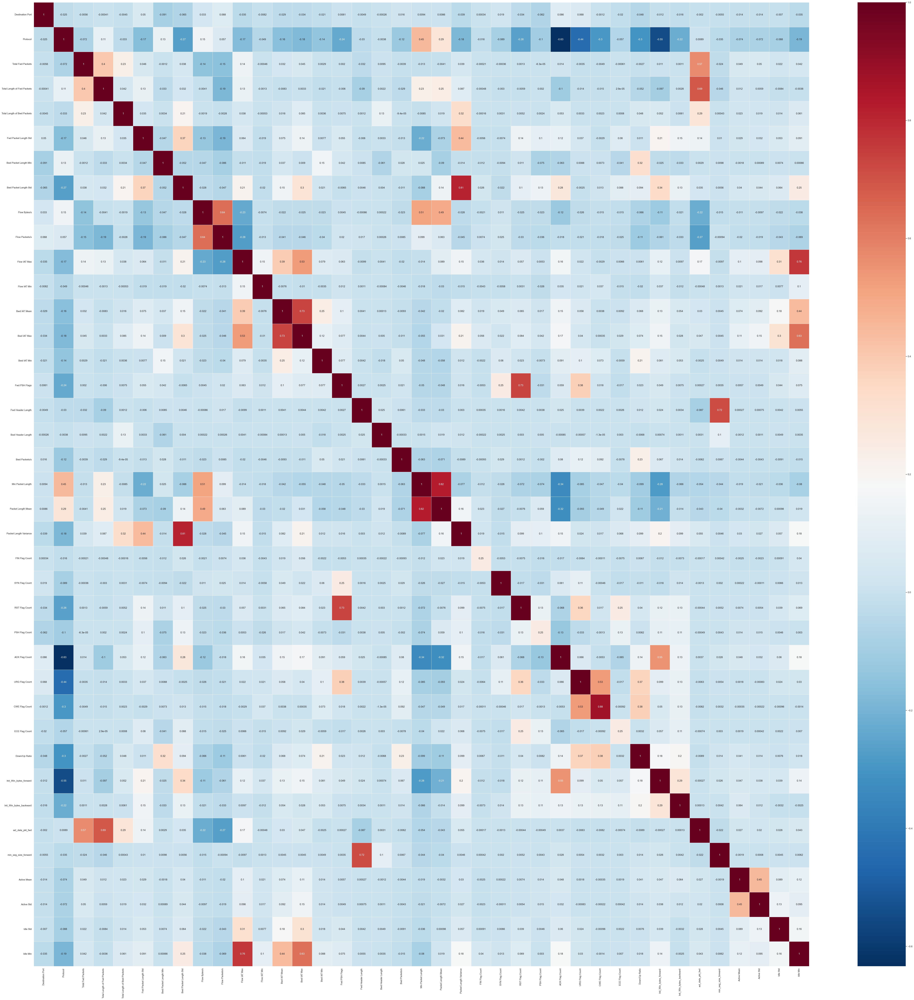

<Figure size 8000x8000 with 0 Axes>

In [5]:
sns.set(rc={"figure.figsize": (80, 80)})
sns.heatmap(
    matrix_corr_pearson / 8,
    xticklabels=matrix_corr_pearson.columns,
    yticklabels=matrix_corr_pearson.columns,
    cmap="RdBu_r",
    annot=True,
    linewidth=0.5,
)
plt.show()
plt.clf()

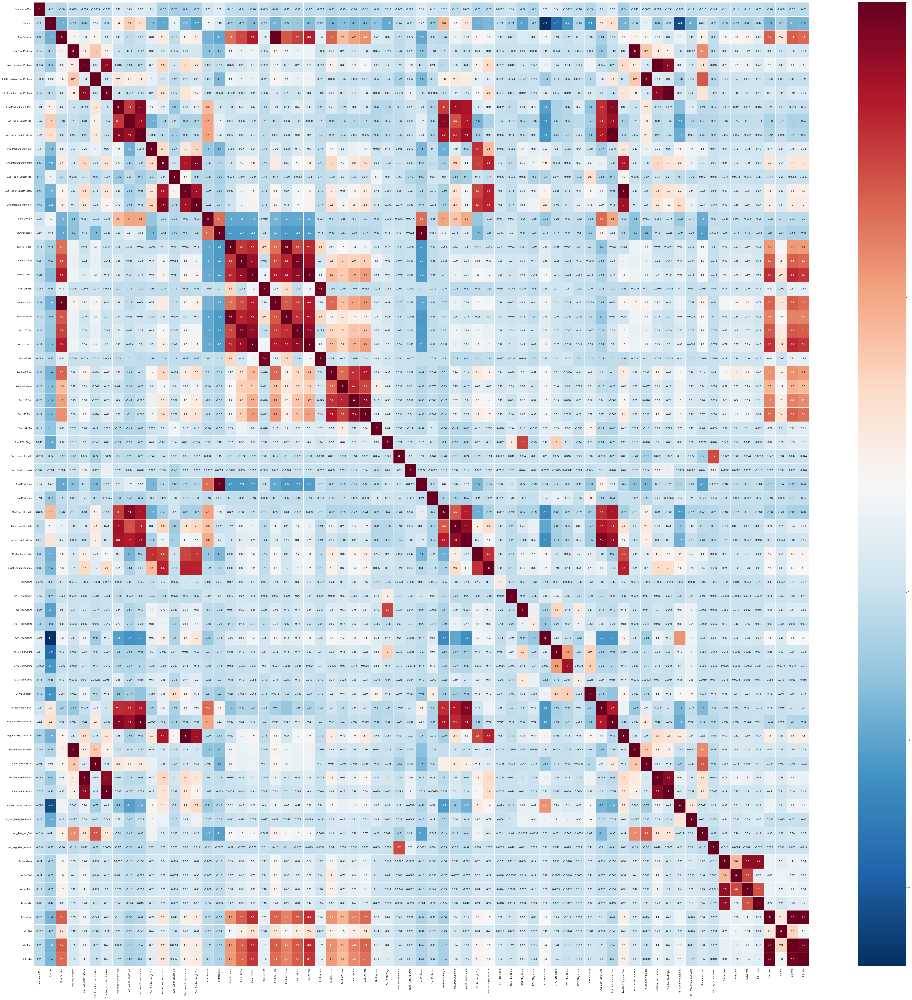

<Figure size 8000x8000 with 0 Axes>

In [7]:
sns.set(rc={"figure.figsize": (80, 80)})
sns.heatmap(
    matrix_corr_pearson_69F,
    xticklabels=matrix_corr_pearson_69F.columns,
    yticklabels=matrix_corr_pearson_69F.columns,
    cmap="RdBu_r",
    annot=True,
    linewidth=0.5,
)
plt.show()
plt.clf()

In [8]:
matrix_corr_pearson.to_csv(os.path.join(datasets_dir, "corr_matrix_39F.csv"))
matrix_corr_pearson_69F.to_csv(os.path.join(datasets_dir, "corr_matrix_69F.csv"))

# Data Transformation


## Spliting the data


In [4]:
df_reader = pd.read_csv(
    os.path.join(datasets_dir, "Cleanned_2.csv"), chunksize=6000000, low_memory=False
)

matrix_corr_pearson = pd.DataFrame()
count_unique = {}
c = 0
attacks = 0
normal = 0
for df in df_reader:
    # creating correlation matrix
    matrix_corr_pearson = matrix_corr_pearson.add(
        df.corr(method="pearson", numeric_only=True), fill_value=0
    )
    df.loc[df["Label"] == "DoS attacks-SlowHTTPTest", "Label"] = "DoS Slowhttptest"
    df.loc[df["Label"] == "DoS attacks-Hulk", "Label"] = "DoS Hulk"
    df.loc[df["Label"] == "DoS attacks-GoldenEye", "Label"] = "DoS GoldenEye"
    df.loc[df["Label"] == "DoS attacks-Slowloris", "Label"] = "DoS slowloris"
    df.loc[df["Label"] == "DDOS attack-HOIC", "Label"] = "DDOS HOIC"
    df.loc[df["Label"] == "DDOS attack-LOIC-UDP", "Label"] = "DDOS LOIC-UDP"
    df.loc[df["Label"] == "DDoS attacks-LOIC-HTTP", "Label"] = "DDoS LOIC-HTTP"
    df.loc[df["Label"] == "DDoS", "Label"] = "DDoS-LOIT"
    df.loc[df["Label"] == "UDPLag", "Label"] = "UDP-lag"
    df.loc[df["Label"] == "Benign", "Label"] = "BENIGN"

    # check unique attacks in the batch
    print(df["Label"].unique())
    for key in df["Label"].unique():
        unique_df = df[df["Label"] == key]["Label"].value_counts()[0]
        if key in count_unique:
            count_unique[key] += unique_df
        else:
            count_unique[key] = unique_df
    c += 1

    # saving the dataset
    save_dataset(df, os.path.join(datasets_dir, "Dataset_Cleaned.csv"))
    save_dataset(
        df[(df["Label"] != "BENIGN")], os.path.join(datasets_dir, "Dataset_Attacks.csv")
    )
    attacks += df[(df["Label"] != "BENIGN")].shape[0]

    save_dataset(
        df[(df["Label"] == "BENIGN")], os.path.join(datasets_dir, "Dataset_Normal.csv")
    )
    normal += df[(df["Label"] == "BENIGN")].shape[0]


# check unique value for each column attacks,event
print("_________ Type attacks _________$")
print("Attacks :", attacks)
print("Normal :", normal)
print("_________              _________$")

['DrDoS_DNS' 'BENIGN' 'DrDoS_LDAP']
0


ParserError: Error tokenizing data. C error: Calling read(nbytes) on source failed. Try engine='python'.

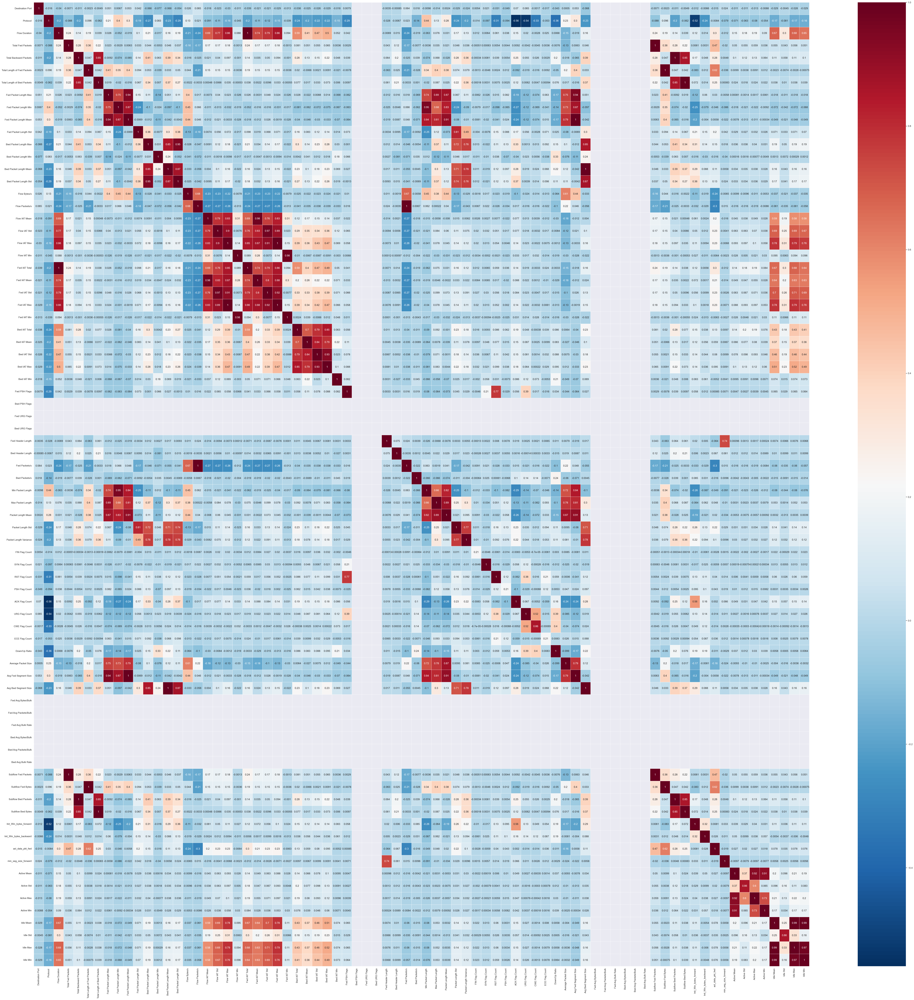

<Figure size 8000x8000 with 0 Axes>

In [9]:
# To find the correlation among
# the columns using pearson method
sns.set(rc={"figure.figsize": (80, 80)})
sns.heatmap(
    matrix_corr_pearson / c,
    xticklabels=matrix_corr_pearson.columns,
    yticklabels=matrix_corr_pearson.columns,
    cmap="RdBu_r",
    annot=True,
    linewidth=0.5,
)
plt.show()
plt.clf()

_________ Type attacks _________$
{'DrDoS_DNS': 4908665, 'BENIGN': 10272356, 'DrDoS_LDAP': 2141300, 'DrDoS_MSSQL': 4396046, 'DrDoS_NetBIOS': 3963446, 'DrDoS_NTP': 1195690, 'DrDoS_SNMP': 5149261, 'DrDoS_SSDP': 2568569, 'DrDoS_UDP': 3094002, 'NetBIOS': 3515894, 'LDAP': 1872139, 'MSSQL': 5584471, 'Portmap': 177197, 'Syn': 5923013, 'TFTP': 19515971, 'UDP': 3790298, 'UDP-lag': 331952, 'WebDDoS': 439, 'DDOS LOIC-UDP': 1730, 'DDOS HOIC': 668461, 'DDoS LOIC-HTTP': 576175, 'DoS Slowhttptest': 34956, 'DoS Hulk': 613461, 'DoS GoldenEye': 51741, 'DoS slowloris': 15977, 'DDoS-LOIT': 128023}
_________              _________$


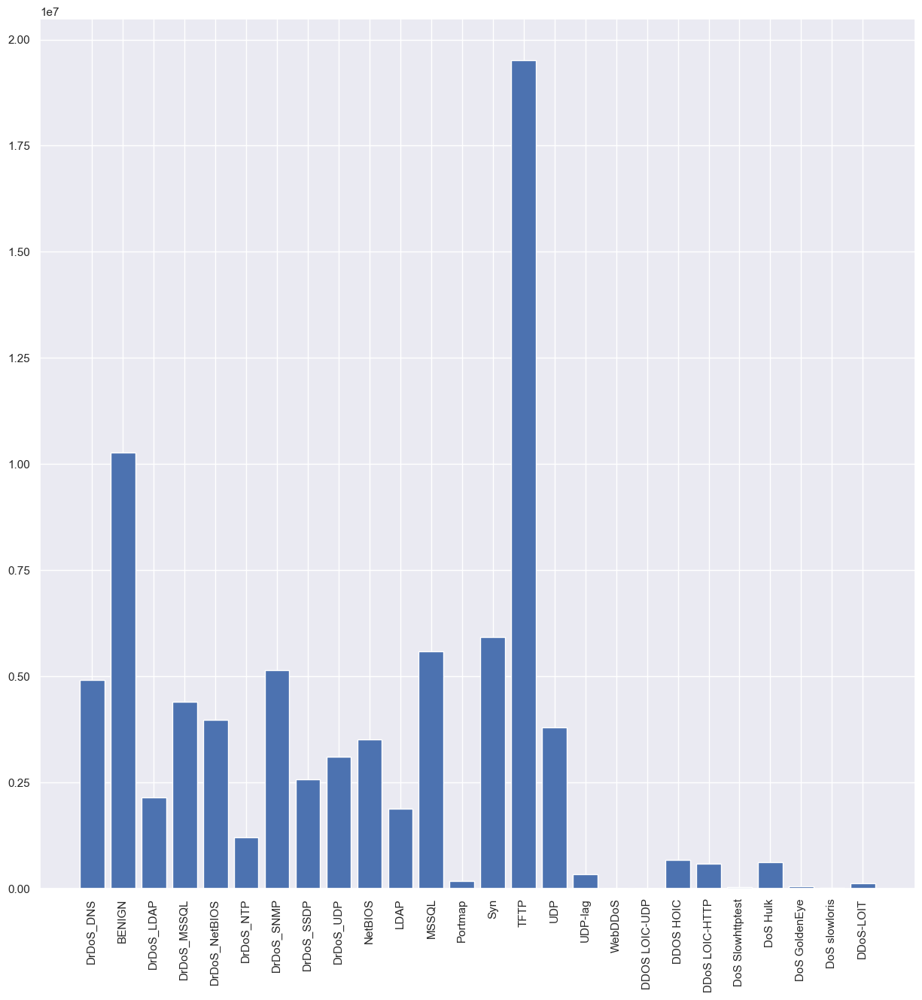

<Figure size 1500x1500 with 0 Axes>

In [38]:
# check unique value for each column attacks,event
print("_________ Type attacks _________$")
print(unique_Labels)
print("_________              _________$")
# Plot Bar chart to understand event total of device
sns.set(rc={"figure.figsize": (15, 15)})
plt.bar(unique_Labels.keys(), unique_Labels.values())
plt.xticks(rotation=90)
plt.show()
plt.clf()

In [10]:
df_r = pd.read_csv("../DataSet/Dataset_Normal.csv", chunksize=500000)
df = next(df_r)
df.drop(
    columns=[
        "Fwd Avg Bytes/Bulk",
        "Fwd Avg Packets/Bulk",
        "Fwd URG Flags",
        "Bwd PSH Flags",
        "Fwd Avg Bulk Rate",
        "Bwd Avg Bytes/Bulk",
        "Bwd Avg Packets/Bulk",
        "Bwd Avg Bulk Rate",
        "Bwd URG Flags",
        "Flow Duration",
        "Flow IAT Mean",
        "Flow IAT Std",
        "Fwd IAT Total",
        "Fwd IAT Mean",
        "Fwd IAT Std",
        "Fwd IAT Max",
        "Idle Mean",
        "Idle Max",
        "Fwd Packet Length Max",
        "Fwd Packet Length Min",
        "Fwd Packet Length Mean",
        "Max Packet Length",
        "Average Packet Size",
        "Avg Fwd Segment Size",
        "Bwd Packet Length Max",
        "Bwd Packet Length Mean",
        "Packet Length Std",
        "Avg Bwd Segment Size",
        "Total Backward Packets",
        "Subflow Bwd Packets",
        "Subflow Bwd Bytes",
        "Active Max",
        "Active Min",
        "Bwd IAT Total",
        "Bwd IAT Std",
        "Subflow Fwd Packets",
        "Subflow Fwd Bytes",
        "Fwd Packets/s",
        "Fwd IAT Min",
        "Timestamp",
    ],
    inplace=True,
)
df.to_csv("D:\Study\IMSI\S5\PFE\DataSet\Dataset_Normal_39F_500000.csv", index=False)

# Attack dataset


## dataset reduction


In [2]:
import pandas as pd

# Define the path to the output dataset CSV file
output_file_path = os.path.join("C:\PFE", "Dataset_Reduced_300.csv")

# Define a dictionary to store the number of samples to select from each label
label_counts = {
    "DrDoS_DNS": 300000,
    "DrDoS_LDAP": 300000,
    "DrDoS_MSSQL": 300000,
    "DrDoS_NetBIOS": 300000,
    "DrDoS_NTP": 300000,
    "DrDoS_SNMP": 300000,
    "DrDoS_SSDP": 300000,
    "DrDoS_UDP": 300000,
    "NetBIOS": 300000,
    "LDAP": 300000,
    "MSSQL": 300000,
    "Portmap": 177197,
    "Syn": 300000,
    "TFTP": 300000,
    "UDP": 300000,
    "UDP-lag": 300000,
    "DDOS HOIC": 300000,
    "DDoS LOIC-HTTP": 300000,
    "DoS Slowhttptest": 34956,
    "DoS Hulk": 300000,
    "DoS GoldenEye": 51741,
    "DoS slowloris": 15977,
    "DDoS-LOIT": 128023,
}

c = 0
df_reader = pd.read_csv(
    os.path.join("C:\PFE", "Dataset_Reduced.csv"), chunksize=6000000, low_memory=False
)
for df in df_reader:
    c = c + 1
    labels = df["Label"].unique()
    print("batch: ", c, labels)
    for label, count in label_counts.items():
        if label in labels and count > 0:
            rows = df[df["Label"] == label].shape[0]
            print(label, rows)

            label_chunk = df[df["Label"] == label].sample(n=min(count, rows))
            label_counts[label] = max(0, count - rows)

            if os.path.isfile(output_file_path):
                print("Updating dataset with", label, label_chunk.shape)
                label_chunk.to_csv(
                    output_file_path, mode="a", index=False, header=False
                )
            else:
                print("Creating dataset", label, label_chunk.shape)
                label_chunk.to_csv(output_file_path, index=False)

print("Dataset reduction Completed")

batch:  1 ['DrDoS_DNS' 'DrDoS_LDAP' 'DrDoS_MSSQL' 'DrDoS_NetBIOS' 'DrDoS_NTP'
 'DrDoS_SNMP' 'DrDoS_SSDP' 'DrDoS_UDP' 'NetBIOS' 'LDAP' 'MSSQL' 'Portmap'
 'Syn']
DrDoS_DNS 500000
Creating dataset DrDoS_DNS (300000, 80)
DrDoS_LDAP 500000
Updating dataset with DrDoS_LDAP (300000, 80)
DrDoS_MSSQL 500000
Updating dataset with DrDoS_MSSQL (300000, 80)
DrDoS_NetBIOS 500000
Updating dataset with DrDoS_NetBIOS (300000, 80)
DrDoS_NTP 500000
Updating dataset with DrDoS_NTP (300000, 80)
DrDoS_SNMP 500000
Updating dataset with DrDoS_SNMP (300000, 80)
DrDoS_SSDP 500000
Updating dataset with DrDoS_SSDP (300000, 80)
DrDoS_UDP 500000
Updating dataset with DrDoS_UDP (300000, 80)
NetBIOS 500000
Updating dataset with NetBIOS (300000, 80)
LDAP 500000
Updating dataset with LDAP (300000, 80)
MSSQL 500000
Updating dataset with MSSQL (300000, 80)
Portmap 177197
Updating dataset with Portmap (177197, 80)
Syn 322803
Updating dataset with Syn (300000, 80)
batch:  2 ['Syn' 'TFTP' 'UDP' 'UDP-lag' 'DDOS HOIC' 'DDoS L

## Pre-processing


In [2]:
df_reader = pd.read_csv(
    os.path.join("C:\PFE", "Dataset_Reduced_300.csv"),
    chunksize=4000000,
    low_memory=False,
)
count_local = {}
for idx, df in enumerate(df_reader):
    for key in df["Label"].unique():
        unique_df = df[df["Label"] == key]["Label"].value_counts()[0]
        if key in count_local:
            count_local[key] += unique_df
        else:
            count_local[key] = unique_df
    print(idx, df.shape)

0 (4000000, 80)
1 (1807894, 80)


_________ Type attacks _________$
{'DrDoS_DNS': 300000, 'DrDoS_LDAP': 300000, 'DrDoS_MSSQL': 300000, 'DrDoS_NetBIOS': 300000, 'DrDoS_NTP': 300000, 'DrDoS_SNMP': 300000, 'DrDoS_SSDP': 300000, 'DrDoS_UDP': 300000, 'NetBIOS': 300000, 'LDAP': 300000, 'MSSQL': 300000, 'Portmap': 177197, 'Syn': 300000, 'TFTP': 300000, 'UDP': 300000, 'UDP-lag': 300000, 'DDOS HOIC': 300000, 'DDoS LOIC-HTTP': 300000, 'DoS Slowhttptest': 34956, 'DoS Hulk': 300000, 'DoS GoldenEye': 51741, 'DoS slowloris': 15977, 'DDoS-LOIT': 128023}
_________              _________$


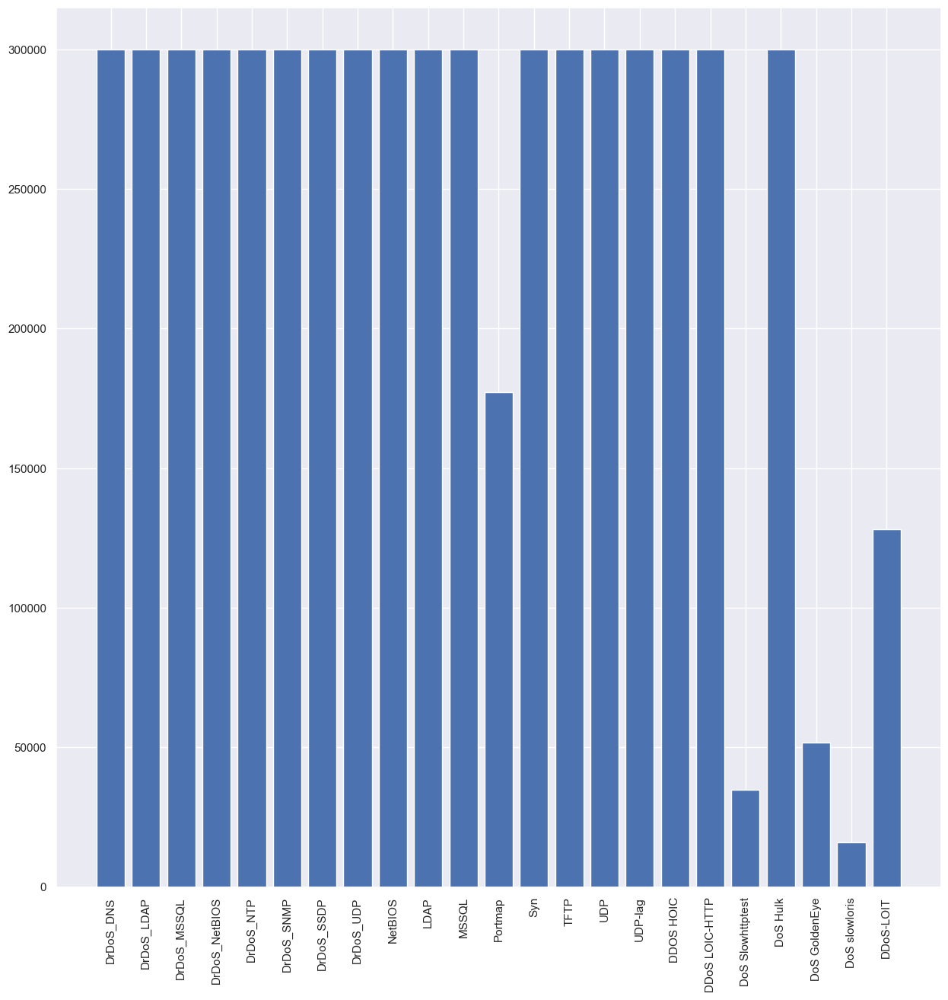

<Figure size 1500x1500 with 0 Axes>

In [3]:
# check unique value for each column attacks,event
print("_________ Type attacks _________$")
print(count_local)
print("_________              _________$")
# Plot Bar chart to understand event total of device
sns.set(rc={"figure.figsize": (15, 15)})
plt.bar(count_local.keys(), count_local.values())
plt.xticks(rotation=90)
plt.show()
plt.clf()

## SMOTE


In [2]:
df = pd.read_csv(os.path.join("C:\PFE", "Dataset_Reduced_300.csv"), low_memory=False)

In [3]:
df.drop(columns=["Timestamp"], inplace=True)

In [34]:
# print(df.shape,df["Label"].value_counts())
a = df["Label"].value_counts() < 500000
print(a)
# print(df.shape,df["Label"].value_counts())

DrDoS_DNS           False
DoS Hulk            False
DDOS HOIC           False
UDP                 False
TFTP                False
Syn                 False
DrDoS_LDAP          False
MSSQL               False
LDAP                False
NetBIOS             False
DrDoS_UDP           False
DrDoS_SSDP          False
DrDoS_SNMP          False
DrDoS_NTP           False
DrDoS_NetBIOS       False
DrDoS_MSSQL         False
DDoS LOIC-HTTP      False
UDP-lag              True
Portmap              True
DDoS-LOIT            True
DoS GoldenEye        True
DoS Slowhttptest     True
DoS slowloris        True
Name: Label, dtype: bool


In [6]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=0)

X, y = smote.fit_resample(df.drop(columns="Label"), df["Label"])

In [8]:
augmented_df = pd.concat([pd.DataFrame(X), pd.DataFrame({"Label": y})], axis=1)

In [9]:
print(augmented_df.shape)
print(df.shape)

(6900000, 79)
(5807894, 79)


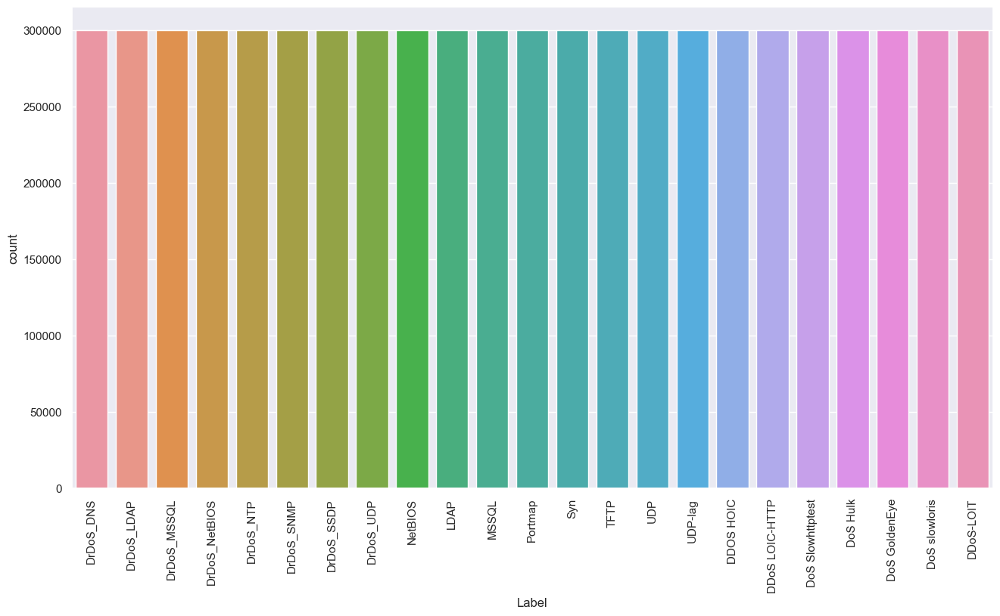

<Figure size 1570x827 with 0 Axes>

In [11]:
sns.set(rc={"figure.figsize": (15.7, 8.27)})
# Plot Bar chart to understand event total of device
p = sns.countplot(x="Label", data=augmented_df)
plt.xticks(rotation=90)
plt.show()
plt.clf()

## Ridge


In [9]:
filename = os.path.join("C:\PFE", "Dataset_Reduced_300.csv")
df = pd.read_csv(filename)
print(df.shape)
df.drop_duplicates()
print(df.shape)

(5807894, 80)
(5807894, 80)


In [ ]:
from sklearn.linear_model import RidgeCV
import matplotlib
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
y = le.fit_transform(df["Label"])
reg = RidgeCV(alphas=[1e-3, 1e-2, 1e-1, 1], cv=5)

reg.fit(df.iloc[:, :-1], y)
print("Best alpha using built-in RidgeCV: %f" % reg.alpha_)
print("Best score using built-in RidgeCV: %f" % reg.score(X, y))

In [ ]:
for a in imp_coef:
    print(a)

In [ ]:
coef = pd.Series(reg.coef_, index=df.iloc[:, :-1].columns)
print(
    "Ridge picked "
    + str(sum(coef != 0))
    + " variables and eliminated the other "
    + str(sum(coef == 0))
    + " variables"
)
imp_coef = coef.sort_values()
print(imp_coef[coef == 0].index)
matplotlib.rcParams["figure.figsize"] = (8.0, 10.0)
imp_coef.plot(kind="barh")
plt.title("Feature importance using Ridge Model")

## data analysis


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df is your DataFrame
numeric_cols = df.select_dtypes(
    include=["float64", "int64", "float32", "int32"]
).columns

for col in numeric_cols:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=df[col])
    plt.title(f"Box plot for {col}")
    plt.show()

In [13]:
df.describe()

C:\Users\mahdj\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\numpy\lib\function_base.py:4527: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
C:\Users\mahdj\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\numpy\lib\function_base.py:4527: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


,Destination Port,Protocol,Flow Duration,Total Fwd Packets,Total Backward Packets,Total Length of Fwd Packets,Total Length of Bwd Packets,Fwd Packet Length Max,Fwd Packet Length Min,Fwd Packet Length Mean,...,act_data_pkt_fwd,min_seg_size_forward,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min
count,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,...,5.807894e+06,5.619451e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06,5.807894e+06
mean,8.984939e+00,2.614387e+00,5.249331e+00,1.365314e+00,1.697670e-01,5.706777e+00,6.412257e-01,4.910348e+00,4.551450e+00,4.815008e+00,...,8.675756e-01,-inf,2.572762e-01,5.654625e-02,2.637719e-01,2.241121e-01,1.134012e+00,2.539641e-01,1.139498e+00,1.124535e+00
std,2.439749e+00,4.297097e-01,5.728925e+00,6.690942e-01,4.921738e-01,2.907698e+00,2.094035e+00,2.480368e+00,2.763690e+00,2.507759e+00,...,8.333236e-01,NaN,1.506431e+00,7.467297e-01,1.534225e+00,1.396191e+00,4.248855e+00,1.976813e+00,4.269406e+00,4.214513e+00
min,0.000000e+00,0.000000e+00,6.931472e-01,6.931472e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,-inf,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,8.457443e+00,1.945910e+00,6.931472e-01,1.098612e+00,0.000000e+00,4.043051e+00,0.000000e+00,3.044522e+00,1.945910e+00,2.268684e+00,...,6.931472e-01,2.197225e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,1.012641e+01,2.890372e+00,1.098612e+00,1.098612e+00,0.000000e+00,6.688355e+00,0.000000e+00,5.950643e+00,5.802118e+00,5.887492e+00,...,6.931472e-01,3.044522e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75%,1.072119e+01,2.890372e+00,1.013349e+01,1.386294e+00,0.000000e+00,7.894691e+00,0.000000e+00,6.248043e+00,6.248043e+00,6.248043e+00,...,6.931472e-01,3.044522e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
max,1.109035e+01,2.890372e+00,1.860300e+01,1.254270e+01,5.746203e+00,1.600843e+01,9.585827e+00,7.592870e+00,7.592870e+00,7.592870e+00,...,1.254270e+01,7.300473e+00,1.793476e+01,1.740197e+01,1.809915e+01,1.793476e+01,1.860300e+01,1.808800e+01,1.860300e+01,1.860300e+01


In [12]:
import numpy as np

# Select numerical columns
numerical_cols = df.select_dtypes(include=[np.number]).columns

# Apply log transformation
for col in numerical_cols:
    # Adding 1 before taking log to avoid division by zero
    df[col] = np.log1p(df[col])

print("Log transformation has been applied.")

C:\Users\mahdj\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\pandas\core\arraylike.py:402: RuntimeWarning: divide by zero encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\mahdj\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\pandas\core\arraylike.py:402: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)


Log transformation has been applied.


In [46]:
df.head(6)

,Model,Accuracy,F1 Score,Precision,Recall
0,CAT,0.987401,0.987446,0.987711,0.987401
1,RF,0.989136,0.989147,0.989282,0.989136
2,XGB,0.990026,0.990056,0.990311,0.990026
3,LGBM,0.990084,0.990111,0.990356,0.990084
4,KNN,0.981850,0.981875,0.982055,0.981850
5,ADA,0.397983,0.341957,0.415417,0.397983


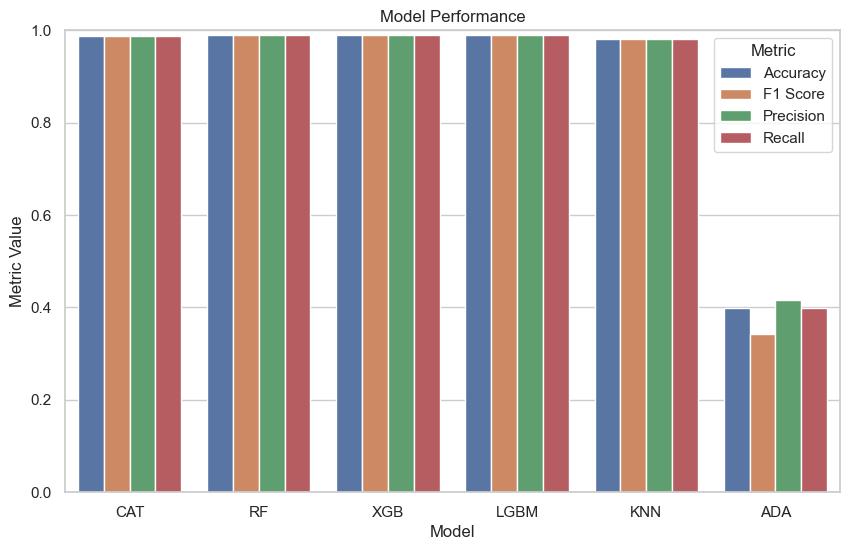

In [54]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Read the CSV file into a pandas DataFrame
r = pd.read_csv("./Attacks_15_50/evaluation_results.csv")

# Plotting the dataset using Seaborn
sns.set(style="whitegrid")

# Plot the data
plt.figure(figsize=(10, 6))
sns.barplot(
    data=r.melt(id_vars="Model", var_name="Metric"), x="Model", y="value", hue="Metric"
)
plt.title("Model Performance")
plt.xlabel("Model")
plt.ylabel("Metric Value")
plt.ylim(0, 1.0)  # Adjust the y-axis limits if needed
plt.legend(title="Metric")

# Display the plot
plt.show()